In [2]:
#Importing the standard libraries
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from matplotlib import patches
import seaborn as sns
import os
import random
import re
import shutil
sns.set_style('darkgrid')
sns.set_palette('pastel')

import warnings
warnings.filterwarnings('ignore')

In [3]:
#Defining the input
input_dir = r'C:\Users\njhar\Downloads\PCB_DATASET'
os.listdir(input_dir)

['Annotations', 'images', 'PCB_USED', 'rotate.py', 'rotation']

In [4]:
template_dir=os.path.join(input_dir,'PCB_USED')
template_dir

'C:\\Users\\njhar\\Downloads\\PCB_DATASET\\PCB_USED'

In [5]:
#Creating function to visualize images:
def visualize_img(dir_name,nos_):
    k=1
    plt.figure(figsize=(8,(nos_//2)*6))
    for filename in os.listdir(dir_name)[0:nos_]:
        if filename.lower().endswith(('.jpg','.jpeg','.png')):
            ax=plt.subplot((nos_//2)+1,2,k)
            img_path=os.path.join(dir_name,filename)
            img=plt.imread(img_path)
            ax.imshow(img)
            ax.set_xlabel(filename)
            ax.grid(False)
            ax.set_xticks([])
            ax.set_yticks([])
            k+=1
    plt.tight_layout()
    plt.show()

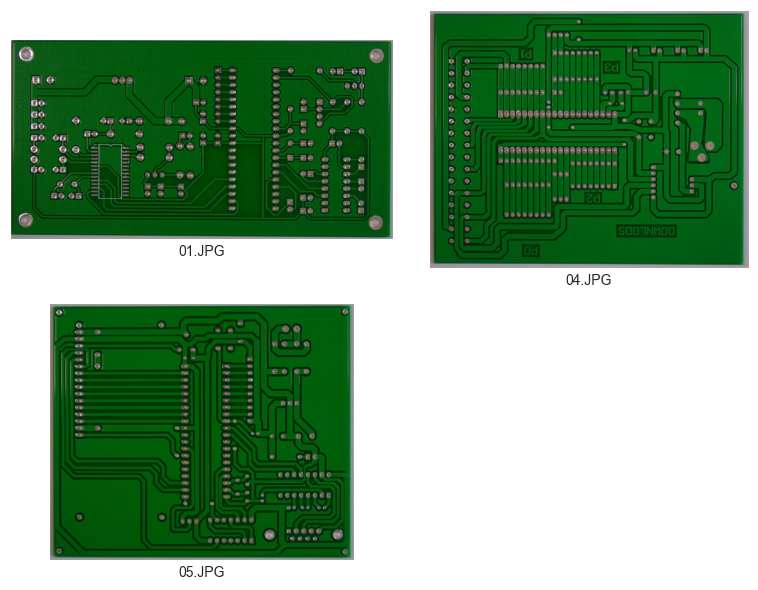

No of template images:10


In [6]:
visualize_img(template_dir,nos_=3)

print(f'No of template images:{len(os.listdir(template_dir))}')

In [7]:
#Defining the image directory
img_dir=os.path.join(input_dir,'images')

#Listing the types of defects
os.listdir(img_dir)
types_defect=os.listdir(os.path.join(input_dir,'images'))
types_defect

['Missing_hole',
 'Mouse_bite',
 'Open_circuit',
 'Short',
 'Spur',
 'Spurious_copper']

In [8]:
#Creating an image path list for ready refernce
img_path_list=[]
#Creating img_path list
for sub_cat in types_defect:
    for file in os.listdir(os.path.join(img_dir,sub_cat)):
    
        img_path_list.append(os.path.join(img_dir,sub_cat,file))

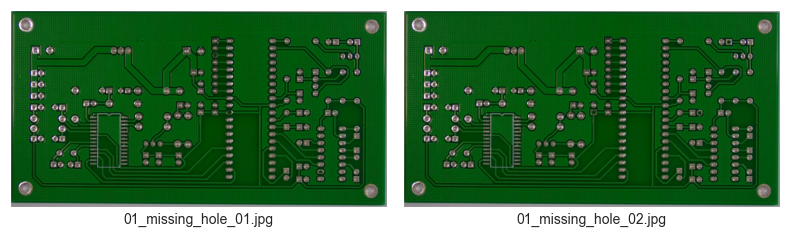

No of Missing_hole images:115


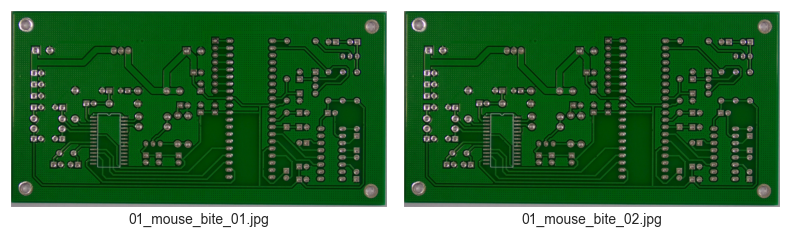

No of Mouse_bite images:115


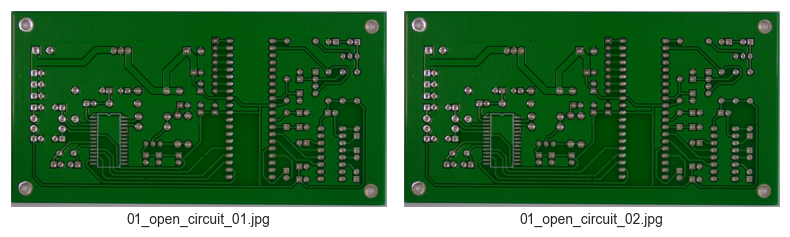

No of Open_circuit images:116


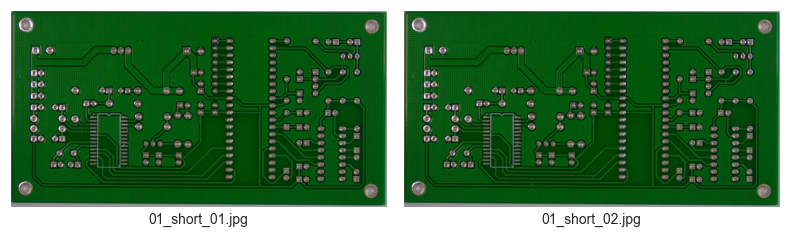

No of Short images:116


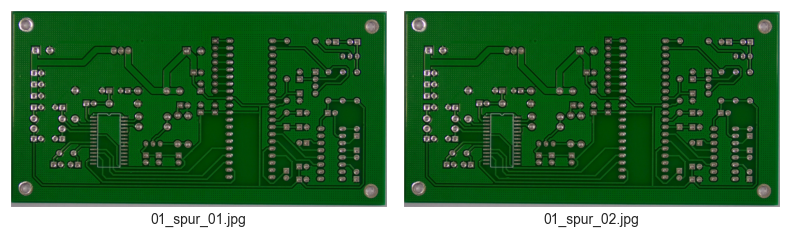

No of Spur images:115


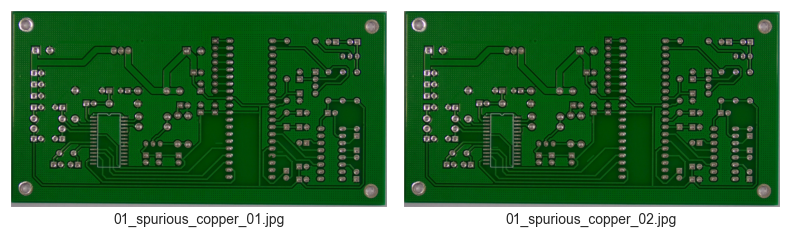

No of Spurious_copper images:116


In [9]:
#Vizualizing defect images for each type
df_defect=pd.DataFrame(columns=['No of defect']) #dataframe for counting no of defects
for sub_cat in types_defect:
    visualize_img(os.path.join(img_dir,sub_cat),nos_=2)  #Visualizing 2 types of defect for each type

    print(f'No of {sub_cat} images:{len(os.listdir(os.path.join(img_dir,sub_cat)))}')
    
    df_defect.loc[sub_cat]=len(os.listdir(os.path.join(img_dir,sub_cat)))

In [10]:
#No. of defects by type
df_defect

,No of defect
Missing_hole,115
Mouse_bite,115
Open_circuit,116
Short,116
Spur,115
Spurious_copper,116


In [11]:
rotated_dir=os.path.join(input_dir,'rotation')
os.listdir(rotated_dir)

['Missing_hole_angles.txt',
 'Missing_hole_rotation',
 'Mouse_bite_angles.txt',
 'Mouse_bite_rotation',
 'Open_circuit_angles.txt',
 'Open_circuit_rotation',
 'Short_angles.txt',
 'Short_rotation',
 'Spurious_copper_angles.txt',
 'Spurious_copper_rotation',
 'Spur_angles.txt',
 'Spur_rotation']

In [12]:
rotated_angle_list=[j for j in os.listdir(rotated_dir) if j.endswith('.txt')]
rotated_angle_list

['Missing_hole_angles.txt',
 'Mouse_bite_angles.txt',
 'Open_circuit_angles.txt',
 'Short_angles.txt',
 'Spurious_copper_angles.txt',
 'Spur_angles.txt']

In [13]:
types_defect_rotated=[j for j in os.listdir(rotated_dir) if j.endswith('.txt')==False]
types_defect_rotated

['Missing_hole_rotation',
 'Mouse_bite_rotation',
 'Open_circuit_rotation',
 'Short_rotation',
 'Spurious_copper_rotation',
 'Spur_rotation']

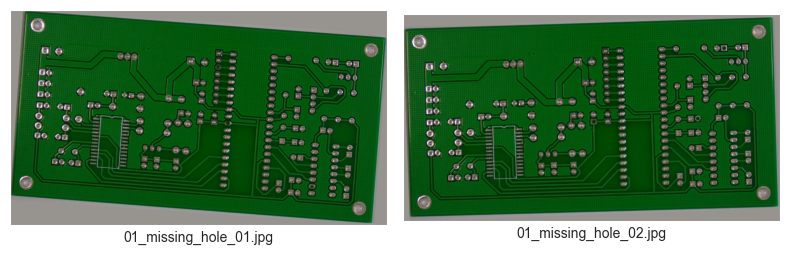

No of Missing_hole_rotation images:115


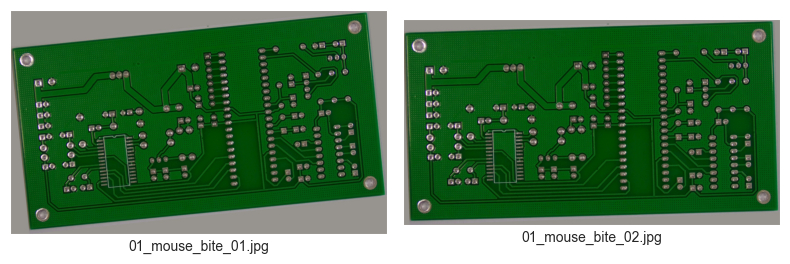

No of Mouse_bite_rotation images:115


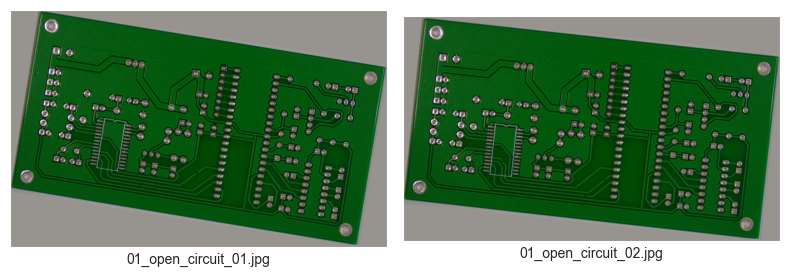

No of Open_circuit_rotation images:116


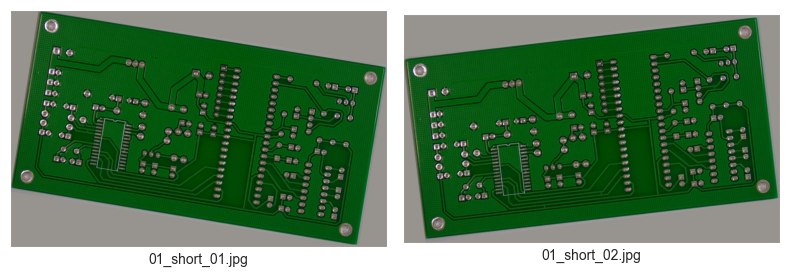

No of Short_rotation images:116


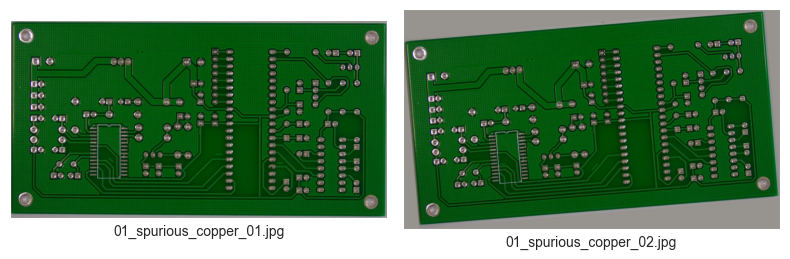

No of Spurious_copper_rotation images:116


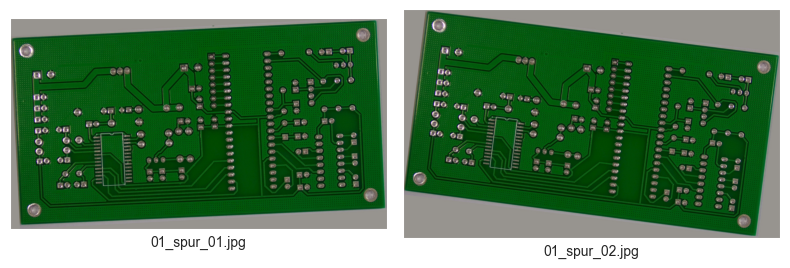

No of Spur_rotation images:115


In [14]:
#Vizualizing rotated defects
df_defect_rotated=pd.DataFrame(columns=['No of defect'])
for sub_cat in types_defect_rotated:
    visualize_img(os.path.join(rotated_dir,sub_cat),nos_=2)

    print(f'No of {sub_cat} images:{len(os.listdir(os.path.join(rotated_dir,sub_cat)))}')
    
    df_defect_rotated.loc[sub_cat]=len(os.listdir(os.path.join(rotated_dir,sub_cat)))

In [15]:
#No. of defects by type  rotated 
df_defect_rotated

,No of defect
Missing_hole_rotation,115
Mouse_bite_rotation,115
Open_circuit_rotation,116
Short_rotation,116
Spurious_copper_rotation,116
Spur_rotation,115


In [16]:
#Reading the rotation text files

df_rotation_angle=pd.DataFrame(columns=['Line','Angle'])
for filename in rotated_angle_list:
    with open(os.path.join(rotated_dir,filename),'r') as f:
        lines=f.readlines()
        for line in lines:
            text,angle=line.split()        
            df_rotation_angle=pd.concat([df_rotation_angle,pd.DataFrame({'Line':[text],'Angle':[angle]})],axis=0)

In [17]:
df_rotation_angle

,Line,Angle
0,08_missing_hole_03,-9
0,05_missing_hole_01,8
0,08_missing_hole_04,2
0,05_missing_hole_10,-10
0,01_missing_hole_13,7
...,...,...
0,04_spur_10,-2
0,04_spur_18,5
0,04_spur_09,9
0,10_spur_02,2


In [18]:
annote_dir=os.path.join(input_dir,'Annotations')
annote_dir

'C:\\Users\\njhar\\Downloads\\PCB_DATASET\\Annotations'

In [19]:
type_annot=os.listdir(annote_dir)
type_annot

['Missing_hole',
 'Mouse_bite',
 'Open_circuit',
 'Short',
 'Spur',
 'Spurious_copper']

In [20]:
df_annot_nos=pd.DataFrame(columns=['No of annotations'])
#Checking the length of annotation itms
for i in type_annot:
    df_annot_nos.loc[i]=len(os.listdir(os.path.join(annote_dir,i)))
df_annot_nos

,No of annotations
Missing_hole,115
Mouse_bite,115
Open_circuit,116
Short,116
Spur,115
Spurious_copper,116


In [21]:
#Checking the type of files
file_list=os.listdir(os.path.join(annote_dir,'Mouse_bite'))
file_list[0:5]

['01_mouse_bite_01.xml',
 '01_mouse_bite_02.xml',
 '01_mouse_bite_03.xml',
 '01_mouse_bite_04.xml',
 '01_mouse_bite_05.xml']

In [22]:
#importing xml ET to parse xml file
import xml.etree.ElementTree as ET

In [23]:
tree = ET.parse(os.path.join(os.path.join(annote_dir,'Mouse_bite'),'01_mouse_bite_11.xml'))
root = tree.getroot()

In [24]:
#getting the structure of XML file
print(ET.tostring(root, encoding='utf8').decode('utf8'))

<?xml version='1.0' encoding='utf8'?>
<annotation>
	<folder>Mouse_bite</folder>
	<filename>01_mouse_bite_11.jpg</filename>
	<path>/home/weapon/Desktop/PCB_DATASET/Mouse_bite/01_mouse_bite_11.jpg</path>
	<source>
		<database>Unknown</database>
	</source>
	<size>
		<width>3034</width>
		<height>1586</height>
		<depth>3</depth>
	</size>
	<segmented>0</segmented>
	<object>
		<name>mouse_bite</name>
		<pose>Unspecified</pose>
		<truncated>0</truncated>
		<difficult>0</difficult>
		<bndbox>
			<xmin>1199</xmin>
			<ymin>966</ymin>
			<xmax>1234</xmax>
			<ymax>1004</ymax>
		</bndbox>
	</object>
	<object>
		<name>mouse_bite</name>
		<pose>Unspecified</pose>
		<truncated>0</truncated>
		<difficult>0</difficult>
		<bndbox>
			<xmin>2042</xmin>
			<ymin>755</ymin>
			<xmax>2073</xmax>
			<ymax>786</ymax>
		</bndbox>
	</object>
	<object>
		<name>mouse_bite</name>
		<pose>Unspecified</pose>
		<truncated>0</truncated>
		<difficult>0</difficult>
		<bndbox>
			<xmin>1472</xmin>
			<ymin>607</ymin>
		

In [25]:
#Parsing XML to return Bounding box dimensions 
def parse_xml(xml_file):
    
    data=[]
    
    tree = ET.parse(xml_file)
    root = tree.getroot()
    
    filename = root.find('filename').text
    width = int(root.find('size/width').text)
    height = int(root.find('size/height').text)
    for obj in root.findall('object'):
        name = obj.find('name').text
        xmin = int(obj.find('bndbox/xmin').text)
        ymin = int(obj.find('bndbox/ymin').text)
        xmax = int(obj.find('bndbox/xmax').text)
        ymax = int(obj.find('bndbox/ymax').text)
        
        data.append({
            'filename': filename,
            'width': width,
            'height': height,
            'class': name,
            'xmin': xmin,
            'ymin': ymin,
            'xmax': xmax,
            'ymax': ymax
        })
        
    return data

In [26]:
#Retrieving data for all files
data=[]
all_data=[]

for x in type_annot:
    for file in os.listdir(os.path.join(annote_dir,x)):
        xml_file_path=os.path.join(os.path.join(annote_dir,x),file)
        data=parse_xml(xml_file_path)
        all_data.extend(data)

In [27]:
#Creating a dataframe to store the annotations
df_annot=pd.DataFrame(all_data)
df_annot

,filename,width,height,class,xmin,ymin,xmax,ymax
0,01_missing_hole_01.jpg,3034,1586,missing_hole,2459,1274,2530,1329
1,01_missing_hole_01.jpg,3034,1586,missing_hole,1613,334,1679,396
2,01_missing_hole_01.jpg,3034,1586,missing_hole,1726,794,1797,854
3,01_missing_hole_02.jpg,3034,1586,missing_hole,2584,232,2650,298
4,01_missing_hole_02.jpg,3034,1586,missing_hole,2366,803,2406,860
...,...,...,...,...,...,...,...,...
2948,12_spurious_copper_10.jpg,2529,2530,spurious_copper,1777,334,1831,426
2949,12_spurious_copper_10.jpg,2529,2530,spurious_copper,1395,935,1457,992
2950,12_spurious_copper_10.jpg,2529,2530,spurious_copper,1837,1441,1871,1530
2951,12_spurious_copper_10.jpg,2529,2530,spurious_copper,1078,1854,1171,1901


Text(0.5, 0, 'No of defects in one PCB')

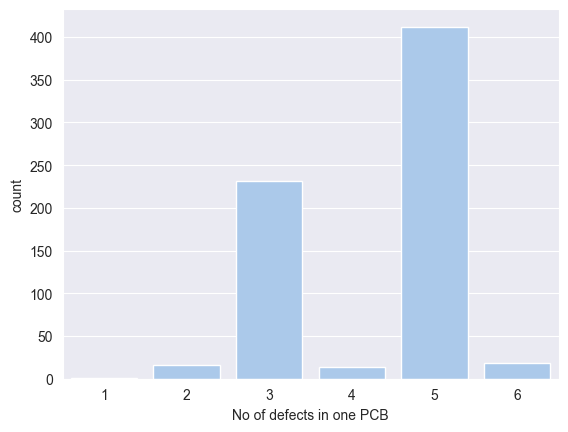

In [28]:
#Visualizing the no of defects in each pcb
df_multiple_defects=pd.DataFrame(df_annot['filename'].value_counts())
sns.countplot(df_multiple_defects,x='count')
plt.xlabel('No of defects in one PCB')

In [29]:
#Defin|g a function to view image along with bounding box

def draw_bounding_boxes(image_path, bounding_boxes,annotation):
    """
    Draws multiple bounding boxes on an image using Matplotlib.

    Args:
        image_path: The path to the image file.
        bounding_boxes: A list of bounding boxes, each represented as a tuple or list containing
                       (min_x, min_y, max_x, max_y).
    """
    
    # Load the image
    img = plt.imread(image_path)

    # Create a figure and axis
    fig, ax = plt.subplots(figsize=(15,10))

    # Display the image
    ax.imshow(img)

    # Draw each bounding box
    for bbox in bounding_boxes:
        min_x, min_y, max_x, max_y = bbox
        width = max_x - min_x
        height = max_y - min_y
        rect = patches.Rectangle((min_x, min_y), width, height, linewidth=1, edgecolor='red', facecolor='none')
        ax.add_patch(rect)
        
        # Calculate the centroid of the bounding box
        centroid_x = (min_x + max_x) / 2
        centroid_y = (min_y + max_y) / 2

        # Add the annotation to the centroid
        ax.annotate( annotation,(centroid_x,centroid_y),(max_x+20,max_y+20),
            fontsize=10,color='white',
            horizontalalignment='right', verticalalignment='top')
        
    plt.grid(False)
    plt.xticks([])
    plt.yticks([])

    # Show the plot
plt.show()

In [30]:
#Getting filename from filepath
filepath=img_path_list[0]
filename=re.sub(r'.+/([\w_]+\.jpg)',r'\1',filepath)
filename


'C:\\Users\\njhar\\Downloads\\PCB_DATASET\\images\\Missing_hole\\01_missing_hole_01.jpg'

In [31]:
#Defining function to select the a file and return image along with bounding box

def visualize_annotations(list_image_path, df):
    for filepath in list_image_path:
        filename = os.path.basename(filepath)  # Ensure correct filename extraction
        df_selected = df[df['filename'] == filename]
        
        if df_selected.empty:
            print(f"Warning: No annotations found for {filename}")
            continue  # Skip this image
        
        width = df_selected['width'].values
        height = df_selected['height'].values
        class_name = df_selected['class'].values
        xmin = df_selected['xmin'].values
        ymin = df_selected['ymin'].values
        xmax = df_selected['xmax'].values
        ymax = df_selected['ymax'].values

        bbox = list(zip(xmin, ymin, xmax, ymax))
        draw_bounding_boxes(filepath, bbox, class_name[0])

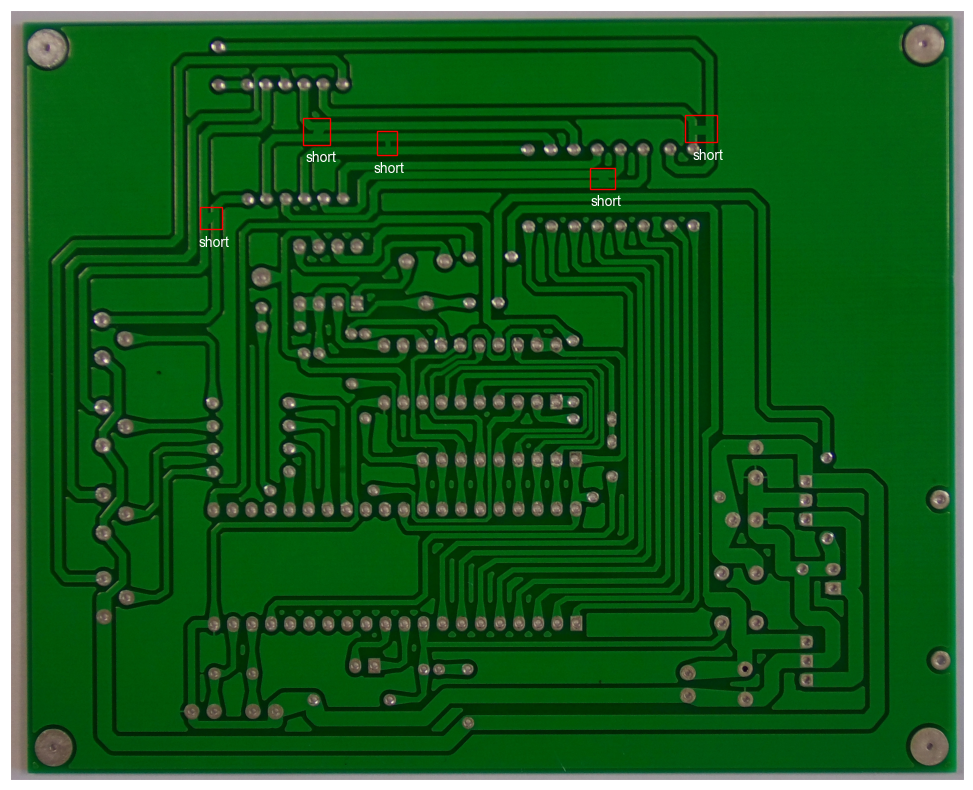

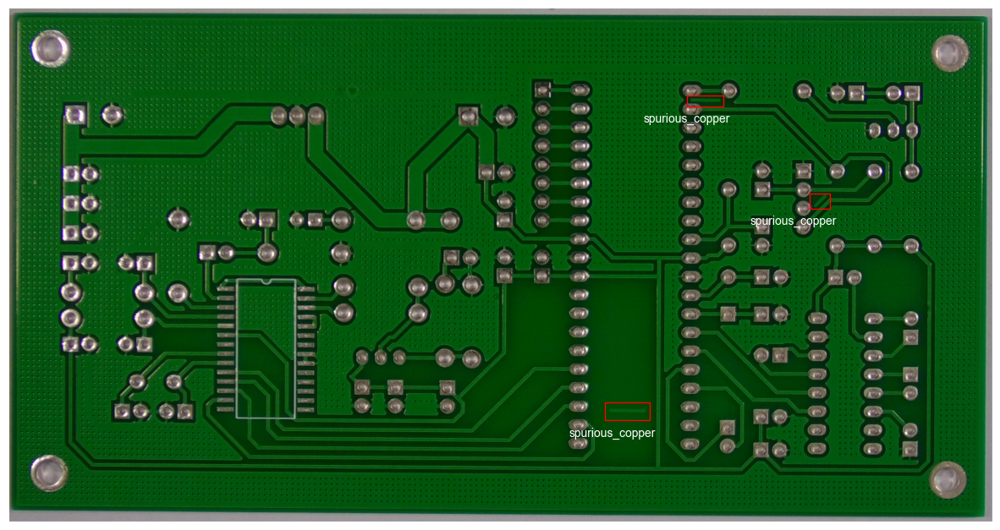

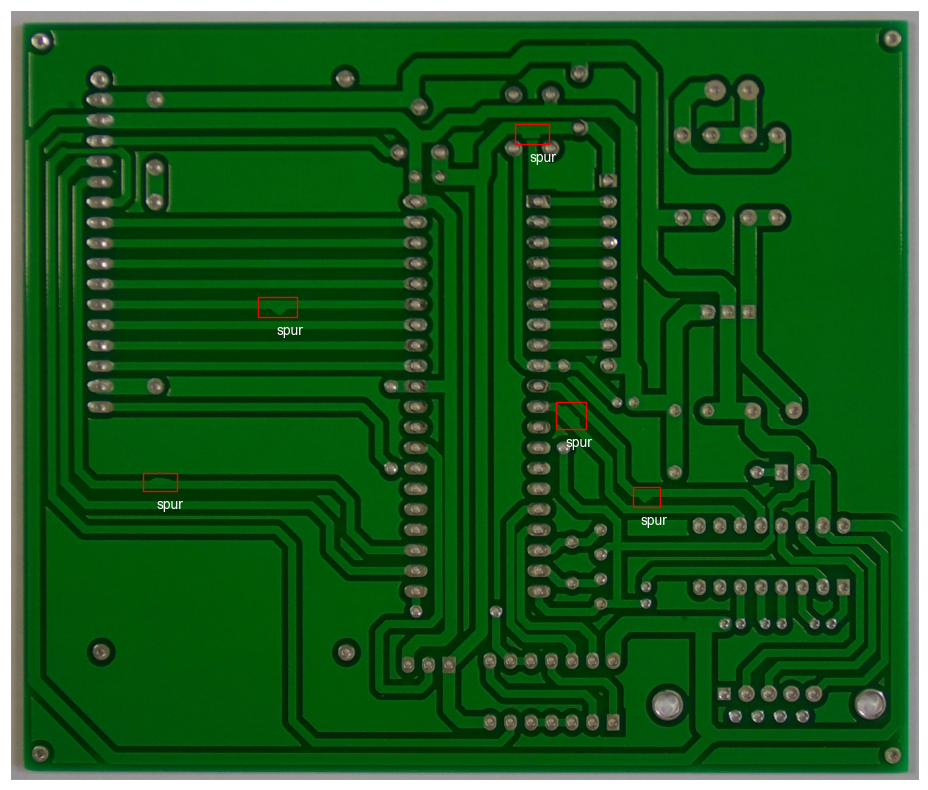

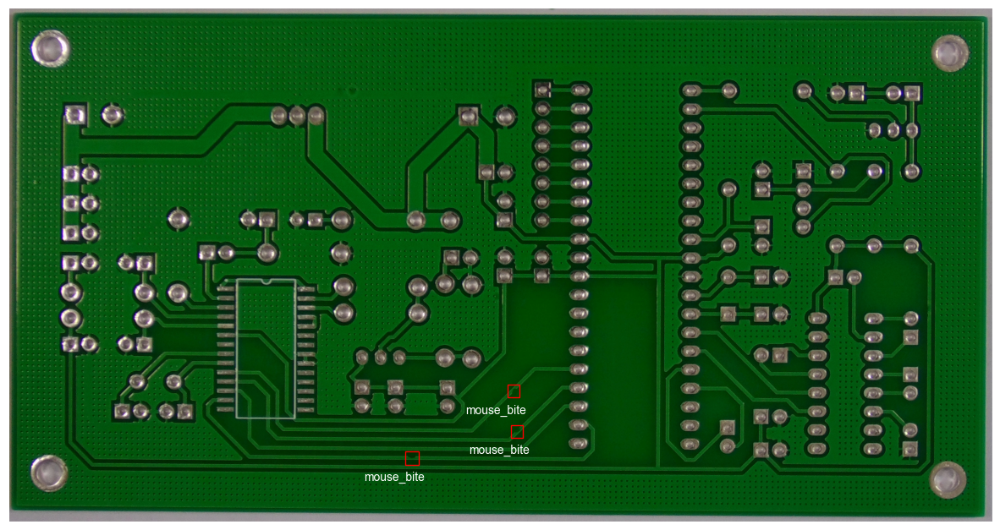

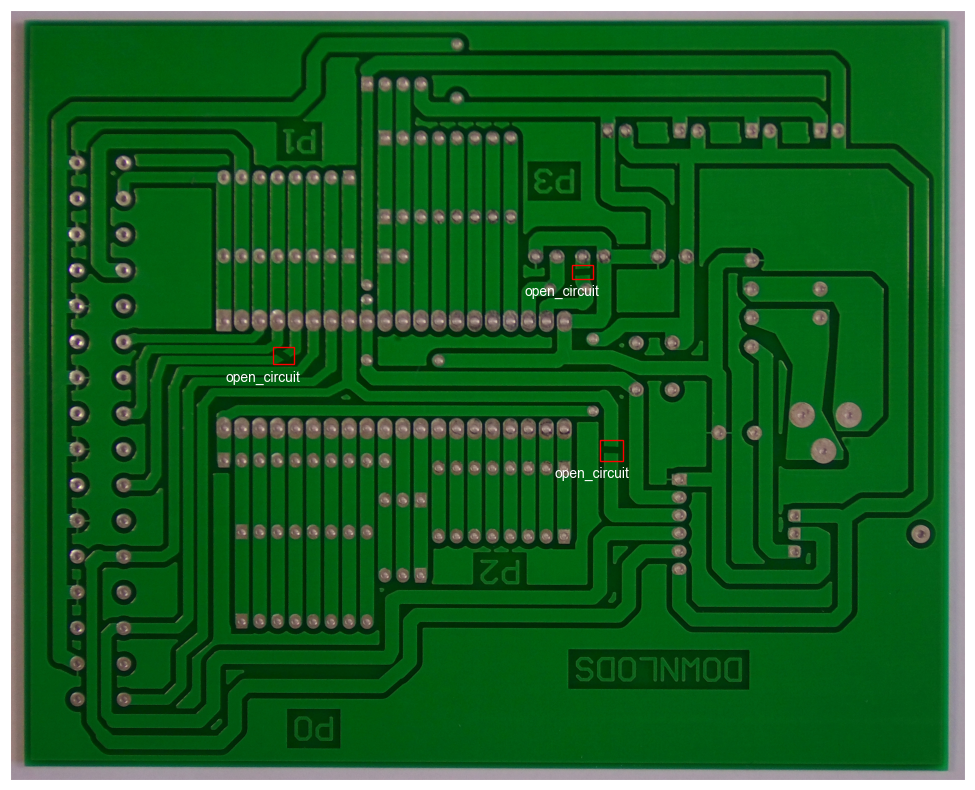

In [32]:
image_path_shuffle = img_path_list[:]
random.shuffle(image_path_shuffle)

visualize_annotations(image_path_shuffle[0:5], df_annot)

# data input for YOLO

In [33]:
df_annot

,filename,width,height,class,xmin,ymin,xmax,ymax
0,01_missing_hole_01.jpg,3034,1586,missing_hole,2459,1274,2530,1329
1,01_missing_hole_01.jpg,3034,1586,missing_hole,1613,334,1679,396
2,01_missing_hole_01.jpg,3034,1586,missing_hole,1726,794,1797,854
3,01_missing_hole_02.jpg,3034,1586,missing_hole,2584,232,2650,298
4,01_missing_hole_02.jpg,3034,1586,missing_hole,2366,803,2406,860
...,...,...,...,...,...,...,...,...
2948,12_spurious_copper_10.jpg,2529,2530,spurious_copper,1777,334,1831,426
2949,12_spurious_copper_10.jpg,2529,2530,spurious_copper,1395,935,1457,992
2950,12_spurious_copper_10.jpg,2529,2530,spurious_copper,1837,1441,1871,1530
2951,12_spurious_copper_10.jpg,2529,2530,spurious_copper,1078,1854,1171,1901


In [34]:
root_dir=os.getcwd()

In [35]:
#Creating the dataset directory along with images and labels sub-directory
os.makedirs(os.path.join(root_dir,'dataset'),exist_ok=True)
dataset_dir=os.path.join(root_dir,'dataset')

images_dir = os.path.join(dataset_dir, 'images')  #images directory
labels_dir = os.path.join(dataset_dir, 'labels')  #annotations directory
os.makedirs(images_dir,exist_ok=True)
os.makedirs(labels_dir,exist_ok=True)

In [36]:
os.listdir(dataset_dir)

['images', 'labels']

In [37]:
#Checking the no of files
len(img_path_list)

693

In [38]:
#Now splitting our images path list for train,val and test
random.seed(42)
random.shuffle(img_path_list)

train_test_split=0.95
train_val_split=0.8

total_train_len=int(len(img_path_list)*train_test_split)
train_len=int(total_train_len*train_val_split)
val_len=total_train_len-train_len
test_len=len(img_path_list)-train_len-val_len

print(f'Train length:{train_len},Validation length:{val_len},Test length:{test_len}')

Train length:526,Validation length:132,Test length:35


In [39]:
def path_to_name(filepath):
    filename=re.sub(r'.+/([\w_]+\.jpg)',r'\1',filepath)
    return filename

In [40]:
import os
import shutil

# Defining a function to copy images from original to target directory
def copy_images_to_dir(original_dir, target_dir, train_len, val_len):
    # Remove all sub-directories if they exist to avoid duplication
    for sub_dir in ['train', 'val', 'test']:
        sub_dir_path = os.path.join(target_dir, sub_dir)
        if os.path.exists(sub_dir_path):
            shutil.rmtree(sub_dir_path)  # Remove existing directories

    # Create new directories within target_dir
    os.makedirs(os.path.join(target_dir, 'train'), exist_ok=True)
    os.makedirs(os.path.join(target_dir, 'val'), exist_ok=True)
    os.makedirs(os.path.join(target_dir, 'test'), exist_ok=True)

    def path_to_name(filepath):
        return os.path.basename(filepath)  # Extract filename from full path

    # Copying files safely (avoid copying a file to itself)
    for filepath in img_path_list[:train_len]:
        filename = path_to_name(filepath)
        dst_path = os.path.join(target_dir, 'train', filename)
        
        if os.path.abspath(filepath) != os.path.abspath(dst_path):  # Prevent SameFileError
            shutil.copy(filepath, dst_path)
        else:
            print(f"Skipping {filepath}: Source and destination are the same.")

    for filepath in img_path_list[train_len:train_len + val_len]:
        filename = path_to_name(filepath)
        dst_path = os.path.join(target_dir, 'val', filename)
        
        if os.path.abspath(filepath) != os.path.abspath(dst_path):  # Prevent SameFileError
            shutil.copy(filepath, dst_path)
        else:
            print(f"Skipping {filepath}: Source and destination are the same.")

    for filepath in img_path_list[train_len + val_len:]:
        filename = path_to_name(filepath)
        dst_path = os.path.join(target_dir, 'test', filename)
        
        if os.path.abspath(filepath) != os.path.abspath(dst_path):  # Prevent SameFileError
            shutil.copy(filepath, dst_path)
        else:
            print(f"Skipping {filepath}: Source and destination are the same.")

# Run the function
copy_images_to_dir(original_dir=input_dir, target_dir=images_dir, train_len=train_len, val_len=val_len)

# Checking the length of files in images dir
print(f"Length of train set: {len(os.listdir(os.path.join(images_dir, 'train')))}")
print(f"Length of val set: {len(os.listdir(os.path.join(images_dir, 'val')))}")
print(f"Length of test set: {len(os.listdir(os.path.join(images_dir, 'test')))}")


Length of train set: 526
Length of val set: 132
Length of test set: 35


In [41]:
for set in ['train','val','test']:
    for filename in os.listdir(os.path.join(images_dir,set)):
        for i in df_annot[df_annot['filename']==filename].index:
              df_annot.loc[i,'set']=set
df_annot['set'].value_counts()

set
train    2238
val       563
test      152
Name: count, dtype: int64

In [42]:
#Defining box dimensions in xywh format [in Normalized format]

df_annot['box_width']=(df_annot['xmax']-df_annot['xmin'])
df_annot['box_height']=(df_annot['ymax']-df_annot['ymin'])

df_annot['x_center']=(df_annot['xmin']+df_annot['box_width']/2)/df_annot['width']
df_annot['y_center']=(df_annot['ymin']+df_annot['box_height']/2)/df_annot['height']

#Normalizing
df_annot['box_width']=df_annot['box_width']/df_annot['width']
df_annot['box_height']=df_annot['box_height']/df_annot['height']
df_annot

,filename,width,height,class,xmin,ymin,xmax,ymax,set,box_width,box_height,x_center,y_center
0,01_missing_hole_01.jpg,3034,1586,missing_hole,2459,1274,2530,1329,val,0.023401,0.034678,0.822182,0.820618
1,01_missing_hole_01.jpg,3034,1586,missing_hole,1613,334,1679,396,val,0.021753,0.039092,0.542518,0.230139
2,01_missing_hole_01.jpg,3034,1586,missing_hole,1726,794,1797,854,val,0.023401,0.037831,0.580587,0.519546
3,01_missing_hole_02.jpg,3034,1586,missing_hole,2584,232,2650,298,train,0.021753,0.041614,0.862558,0.167087
4,01_missing_hole_02.jpg,3034,1586,missing_hole,2366,803,2406,860,train,0.013184,0.035939,0.786421,0.524275
...,...,...,...,...,...,...,...,...,...,...,...,...,...
2948,12_spurious_copper_10.jpg,2529,2530,spurious_copper,1777,334,1831,426,train,0.021352,0.036364,0.713325,0.150198
2949,12_spurious_copper_10.jpg,2529,2530,spurious_copper,1395,935,1457,992,train,0.024516,0.022530,0.563859,0.380830
2950,12_spurious_copper_10.jpg,2529,2530,spurious_copper,1837,1441,1871,1530,train,0.013444,0.035178,0.733096,0.587154
2951,12_spurious_copper_10.jpg,2529,2530,spurious_copper,1078,1854,1171,1901,train,0.036773,0.018577,0.444642,0.742095


In [43]:
class_dict=dict(enumerate(df_annot['class'].unique()))
#Preparing the text files
class_dict

{0: 'missing_hole',
 1: 'mouse_bite',
 2: 'open_circuit',
 3: 'short',
 4: 'spur',
 5: 'spurious_copper'}

In [44]:
reverse_dict={v: k for k, v in class_dict.items()}
df_annot['class_label']=df_annot['class'].map(reverse_dict)
df_annot

,filename,width,height,class,xmin,ymin,xmax,ymax,set,box_width,box_height,x_center,y_center,class_label
0,01_missing_hole_01.jpg,3034,1586,missing_hole,2459,1274,2530,1329,val,0.023401,0.034678,0.822182,0.820618,0
1,01_missing_hole_01.jpg,3034,1586,missing_hole,1613,334,1679,396,val,0.021753,0.039092,0.542518,0.230139,0
2,01_missing_hole_01.jpg,3034,1586,missing_hole,1726,794,1797,854,val,0.023401,0.037831,0.580587,0.519546,0
3,01_missing_hole_02.jpg,3034,1586,missing_hole,2584,232,2650,298,train,0.021753,0.041614,0.862558,0.167087,0
4,01_missing_hole_02.jpg,3034,1586,missing_hole,2366,803,2406,860,train,0.013184,0.035939,0.786421,0.524275,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2948,12_spurious_copper_10.jpg,2529,2530,spurious_copper,1777,334,1831,426,train,0.021352,0.036364,0.713325,0.150198,5
2949,12_spurious_copper_10.jpg,2529,2530,spurious_copper,1395,935,1457,992,train,0.024516,0.022530,0.563859,0.380830,5
2950,12_spurious_copper_10.jpg,2529,2530,spurious_copper,1837,1441,1871,1530,train,0.013444,0.035178,0.733096,0.587154,5
2951,12_spurious_copper_10.jpg,2529,2530,spurious_copper,1078,1854,1171,1901,train,0.036773,0.018577,0.444642,0.742095,5


In [45]:
#Defining a funation to create labels dir from dataframe

def create_labels_from_df(label_dir,images_dir,df):
    
     #Removing all sub-directories ,if exists, to remove duplication
    if os.path.exists(os.path.join(label_dir,'train')):
        shutil.rmtree(os.path.join(label_dir,'train')) 
        shutil.rmtree(os.path.join(label_dir,'val'))
        shutil.rmtree(os.path.join(label_dir,'test'))
                 

    #Making new dircetories within label_dir
    os.makedirs(os.path.join(label_dir,'train'),exist_ok=True)
    os.makedirs(os.path.join(label_dir,'val'),exist_ok=True)
    os.makedirs(os.path.join(label_dir,'test'),exist_ok=True)


    #Creating label .txt file in YOLO format
    for i in ['train','test','val']:
        for file_path in os.listdir(os.path.join(images_dir,i)):
            df_temp=df[df['filename']==file_path]
            txt_file_name=".".join([file_path.split('.')[0],'txt'])
            if os.path.exists(os.path.join(label_dir,i,txt_file_name)):
                continue
            else:
                for index, row in df_temp.iterrows():
                    with open(os.path.join(label_dir,i,txt_file_name),'a') as file:
                        file.write(f"{row['class_label']} {row['x_center']} {row['y_center']} {row['box_width']} {row['box_height']}\n" )


                 
create_labels_from_df(labels_dir,images_dir,df=df_annot)
#Checking the length of files in annotation dir
print(f"Length of train set:{len(os.listdir(os.path.join(labels_dir,'train')))}")
print(f"Length of val set:{len(os.listdir(os.path.join(labels_dir,'val')))}")
print(f"Length of test set:{len(os.listdir(os.path.join(labels_dir,'test')))}")

Length of train set:526
Length of val set:132
Length of test set:35


# preparing model

In [46]:
#Creating YAML format
data_yaml={
    'path':str(os.path.join(root_dir,'dataset')),
    'train':'images/train',
    'val':'images/val',
    'test':'images/test',
    'nc': len(class_dict),
    'names': list(class_dict.values())
}
data_yaml

{'path': 'c:\\Users\\njhar\\Downloads\\dataset',
 'train': 'images/train',
 'val': 'images/val',
 'test': 'images/test',
 'nc': 6,
 'names': ['missing_hole',
  'mouse_bite',
  'open_circuit',
  'short',
  'spur',
  'spurious_copper']}

In [47]:
#Creating yaml file
import yaml

#Writing to yaml file
with open('data.yaml', 'w') as f:
    yaml.dump(data_yaml, f, default_flow_style=False)

In [48]:
#Training YOLO model
from ultralytics import YOLO
import ultralytics as ultralytics

In [49]:
#Loading model
model=YOLO('yolov8n.pt')

100%|██████████| 6.25M/6.25M [00:02<00:00, 2.67MB/s]


In [50]:
#Disabling weights & biases metrics
os.environ['WANDB_MODE'] = 'disabled'

In [51]:
results = model.train(
    data=os.path.join(root_dir, 'data.yaml'), 
    epochs=20, 
    imgsz=416,  # Reduce image size from 640 → 416 (faster training)
    batch=16,    # Reduce batch size (to avoid memory overload)
    workers=8,  # Use 2 workers to avoid CPU overload Use CPU if you don’t have a strong GPU# Disable half precision (only works on NVIDIA GPUs)
)

Ultralytics 8.3.96  Python-3.12.1 torch-2.6.0+cpu CPU (11th Gen Intel Core(TM) i5-1135G7 2.40GHz)
engine\trainer: task=detect, mode=train, model=yolov8n.pt, data=c:\Users\njhar\Downloads\data.yaml, epochs=20, time=None, patience=100, batch=16, imgsz=416, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=train, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_txt=False, save_conf=False, save_crop=False, show_labels=True, sh

train: Scanning C:\Users\njhar\Downloads\dataset\labels\train... 526 images, 0 backgrounds, 0 corrupt: 100%|██████████| 526/526 [00:03<00:00, 148.98it/s]

train: New cache created: C:\Users\njhar\Downloads\dataset\labels\train.cache


albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))


val: Scanning C:\Users\njhar\Downloads\dataset\labels\val... 132 images, 0 backgrounds, 0 corrupt: 100%|██████████| 132/132 [00:00<00:00, 139.64it/s]

val: New cache created: C:\Users\njhar\Downloads\dataset\labels\val.cache


Plotting labels to runs\detect\train\labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.001, momentum=0.9) with parameter groups 57 weight(decay=0.0), 64 weight(decay=0.0005), 63 bias(decay=0.0)
TensorBoard: model graph visualization added 
Image sizes 416 train, 416 val
Using 0 dataloader workers
Logging results to runs\detect\train
Starting training for 20 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       1/20         0G      4.676       10.9      1.906         97        416: 100%|██████████| 33/33 [01:42<00:00,  3.11s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:13<00:00,  2.65s/it]

                   all        132        563          0          0          0          0



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       2/20         0G      3.961      5.823      1.239        110        416: 100%|██████████| 33/33 [02:43<00:00,  4.96s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:25<00:00,  5.02s/it]

                   all        132        563    3.9e-05    0.00314   4.06e-05   1.51e-05



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       3/20         0G      3.682      5.023      1.174        128        416: 100%|██████████| 33/33 [02:01<00:00,  3.69s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:13<00:00,  2.68s/it]

                   all        132        563    0.00123      0.112    0.00849    0.00245



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       4/20         0G      3.492      4.518      1.094        101        416: 100%|██████████| 33/33 [01:37<00:00,  2.94s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:14<00:00,  2.84s/it]

                   all        132        563      0.112      0.117     0.0642     0.0236



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       5/20         0G      3.274      3.958      1.062         95        416: 100%|██████████| 33/33 [02:25<00:00,  4.42s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:12<00:00,  2.55s/it]

                   all        132        563      0.204      0.178      0.122     0.0399



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       6/20         0G      3.221      3.709      1.039         76        416: 100%|██████████| 33/33 [01:37<00:00,  2.95s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:12<00:00,  2.60s/it]

                   all        132        563      0.257      0.186      0.142     0.0467



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       7/20         0G      3.069      3.521      1.001         86        416: 100%|██████████| 33/33 [01:34<00:00,  2.88s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:12<00:00,  2.52s/it]

                   all        132        563       0.29      0.242      0.209     0.0741



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       8/20         0G      2.992      3.297     0.9809         96        416: 100%|██████████| 33/33 [01:34<00:00,  2.87s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:12<00:00,  2.50s/it]

                   all        132        563      0.389      0.296      0.265     0.0998



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       9/20         0G      2.908      3.179     0.9918        108        416: 100%|██████████| 33/33 [01:38<00:00,  3.00s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:12<00:00,  2.52s/it]

                   all        132        563       0.43      0.314      0.294      0.107



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      10/20         0G      2.922      3.117      1.001        105        416: 100%|██████████| 33/33 [01:38<00:00,  2.99s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:12<00:00,  2.51s/it]

                   all        132        563      0.508      0.282       0.29      0.116


Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      11/20         0G      2.731      2.921      1.016         58        416: 100%|██████████| 33/33 [01:36<00:00,  2.93s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:12<00:00,  2.47s/it]

                   all        132        563      0.476      0.325      0.309      0.124



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      12/20         0G      2.626      2.734     0.9707         59        416: 100%|██████████| 33/33 [01:38<00:00,  2.98s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:12<00:00,  2.50s/it]

                   all        132        563      0.487      0.363      0.319      0.123



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      13/20         0G      2.511      2.612     0.9674         57        416: 100%|██████████| 33/33 [01:36<00:00,  2.94s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:12<00:00,  2.50s/it]

                   all        132        563      0.509      0.353      0.348      0.128



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      14/20         0G      2.526      2.553     0.9764         51        416: 100%|██████████| 33/33 [01:36<00:00,  2.93s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:12<00:00,  2.50s/it]

                   all        132        563      0.529      0.398       0.38      0.149



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      15/20         0G       2.47      2.466     0.9752         59        416: 100%|██████████| 33/33 [01:37<00:00,  2.97s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:12<00:00,  2.56s/it]

                   all        132        563      0.509      0.407      0.389      0.151



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      16/20         0G      2.494      2.488     0.9606         50        416: 100%|██████████| 33/33 [01:41<00:00,  3.08s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:12<00:00,  2.59s/it]

                   all        132        563      0.534      0.393       0.39      0.159



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      17/20         0G      2.391       2.29       0.96         49        416: 100%|██████████| 33/33 [01:42<00:00,  3.09s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:13<00:00,  2.76s/it]

                   all        132        563      0.543      0.408      0.422      0.177



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      18/20         0G      2.368      2.279      0.955         54        416: 100%|██████████| 33/33 [01:42<00:00,  3.10s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:12<00:00,  2.59s/it]

                   all        132        563      0.557      0.435       0.44       0.18



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      19/20         0G      2.367      2.264     0.9433         55        416: 100%|██████████| 33/33 [01:42<00:00,  3.10s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:12<00:00,  2.59s/it]

                   all        132        563      0.529      0.442      0.438      0.183



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      20/20         0G      2.373      2.246     0.9433         56        416: 100%|██████████| 33/33 [01:42<00:00,  3.12s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:13<00:00,  2.65s/it]

                   all        132        563      0.577      0.446      0.445      0.189



20 epochs completed in 0.666 hours.
Optimizer stripped from runs\detect\train\weights\last.pt, 6.2MB
Optimizer stripped from runs\detect\train\weights\best.pt, 6.2MB

Validating runs\detect\train\weights\best.pt...
Ultralytics 8.3.96  Python-3.12.1 torch-2.6.0+cpu CPU (11th Gen Intel Core(TM) i5-1135G7 2.40GHz)
Model summary (fused): 72 layers, 3,006,818 parameters, 0 gradients, 8.1 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:12<00:00,  2.47s/it]


                   all        132        563      0.577      0.447      0.445      0.189
          missing_hole         23        106      0.861      0.877      0.944      0.507
            mouse_bite         20         89      0.447       0.36       0.31     0.0987
          open_circuit         21         82      0.443      0.366      0.315      0.124
                 short         18         65      0.623      0.477      0.469      0.181
                  spur         23         96       0.35       0.25      0.199     0.0732
       spurious_copper         27        125      0.738      0.352      0.434      0.154
Speed: 1.0ms preprocess, 35.5ms inference, 0.0ms loss, 0.6ms postprocess per image
Results saved to runs\detect\train


In [88]:
import os
import torch

# Defining the result dir
result_dir = 'runs/detect/train'

# Ensure the directory exists
os.makedirs(result_dir, exist_ok=True)

# Assuming `best_model` is your trained YOLO model
model_path = os.path.join(result_dir, 'yolo_model.pt')

# Now you can list the contents of the directory
print(os.listdir(result_dir))

['args.yaml', 'confusion_matrix.png', 'confusion_matrix_normalized.png', 'events.out.tfevents.1742975268.Harish.20996.0', 'F1_curve.png', 'labels.jpg', 'labels_correlogram.jpg', 'PR_curve.png', 'P_curve.png', 'results.csv', 'results.png', 'R_curve.png', 'train_batch0.jpg', 'train_batch1.jpg', 'train_batch2.jpg', 'train_batch330.jpg', 'train_batch331.jpg', 'train_batch332.jpg', 'val_batch0_labels.jpg', 'val_batch0_pred.jpg', 'val_batch1_labels.jpg', 'val_batch1_pred.jpg', 'val_batch2_labels.jpg', 'val_batch2_pred.jpg', 'weights', 'yolo_model.pt']


In [56]:
df_result=pd.read_csv(os.path.join(result_dir,'results.csv'))
df_result

,epoch,time,train/box_loss,train/cls_loss,train/dfl_loss,metrics/precision(B),metrics/recall(B),metrics/mAP50(B),metrics/mAP50-95(B),val/box_loss,val/cls_loss,val/dfl_loss,lr/pg0,lr/pg1,lr/pg2
0,1,121.842,4.67633,10.90130,1.90590,0.00000,0.00000,0.00000,0.00000,3.88773,6.69765,1.20835,0.000320,0.000320,0.000320
1,2,310.875,3.96100,5.82287,1.23941,0.00004,0.00314,0.00004,0.00002,3.93399,5.83721,1.23069,0.000618,0.000618,0.000618
2,3,446.781,3.68220,5.02288,1.17438,0.00123,0.11172,0.00849,0.00245,3.33473,4.98027,1.10556,0.000883,0.000883,0.000883
3,4,558.356,3.49180,4.51815,1.09354,0.11167,0.11728,0.06421,0.02364,3.18485,4.48846,1.08159,0.000852,0.000852,0.000852
4,5,717.274,3.27377,3.95763,1.06236,0.20372,0.17837,0.12182,0.03993,3.08559,3.76624,1.06972,0.000802,0.000802,0.000802
5,6,827.973,3.22139,3.70872,1.03935,0.25661,0.18575,0.14202,0.04673,2.98976,3.62866,1.03922,0.000753,0.000753,0.000753
6,7,935.823,3.06935,3.52076,1.00138,0.29018,0.24249,0.20890,0.07409,2.72168,3.23952,0.99579,0.000703,0.000703,0.000703
7,8,1043.370,2.99156,3.29699,0.98089,0.38885,0.29643,0.26474,0.09981,2.73551,2.95685,0.98660,0.000654,0.000654,0.000654
8,9,1155.210,2.90826,3.17931,0.99179,0.43021,0.31357,0.29399,0.10712,2.75926,2.92349,0.99442,0.000604,0.000604,0.000604
9,10,1266.920,2.92207,3.11729,1.00063,0.50826,0.28192,0.28966,0.11601,2.73902,2.86834,0.97641,0.000554,0.000554,0.000554


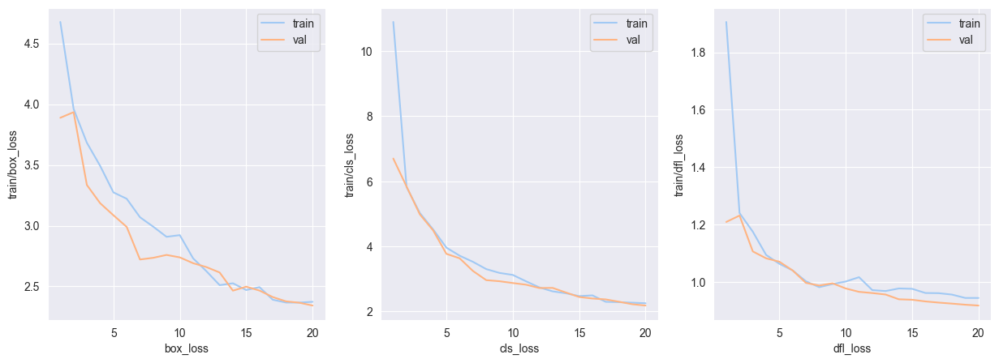

In [58]:
#Plotting the losses
plt.figure(figsize=(15,5))
k=1
for i in ['box_loss','cls_loss','dfl_loss']:
    ax=plt.subplot(1,3,k)
    sns.lineplot(df_result,x='epoch',y='train/'+i,label='train',ax=ax)
    sns.lineplot(df_result,x='epoch',y='val/'+i,label='val',ax=ax)
    ax.set_xlabel(i)
    k+=1

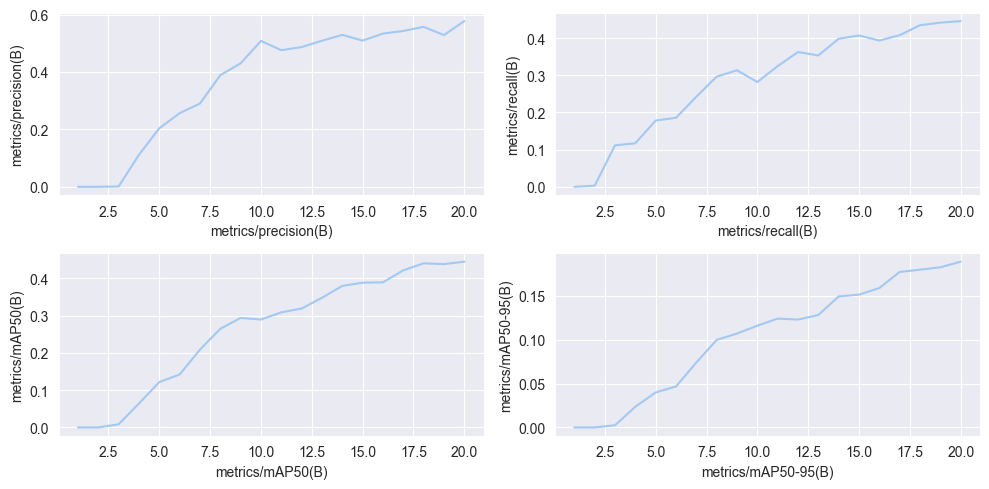

In [59]:
#Plotting the metrics
plt.figure(figsize=(10,5))
k=1
for i in ['metrics/precision(B)','metrics/recall(B)','metrics/mAP50(B)','metrics/mAP50-95(B)']:
    ax=plt.subplot(2,2,k)
    sns.lineplot(df_result,x='epoch',y=i,ax=ax)
    ax.set_xlabel(i)
    k+=1
plt.tight_layout()

In [60]:
#Creating function to visualize result:
def visualize_result(dir_name,list_images):
    k=1
    plt.figure(figsize=(20,15))
    for filename in list_images:
            ax=plt.subplot((len(list_images)//2+1),2,k)
            img_path=os.path.join(dir_name,filename)
            img=plt.imread(img_path)
            ax.imshow(img)
            ax.set_xlabel(filename)
            ax.grid(False)
            ax.set_xticks([])
            ax.set_yticks([])
            k+=1
plt.tight_layout()        
plt.show()

<Figure size 640x480 with 0 Axes>

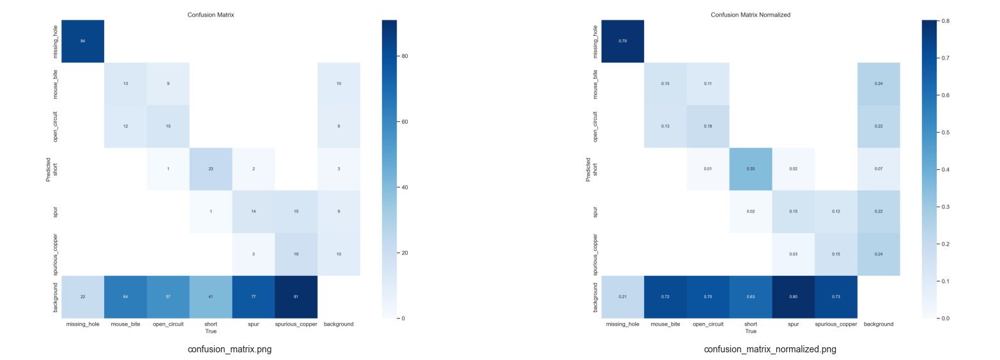

In [61]:
#Visualizing confusion matrix
list_confusion=['confusion_matrix.png','confusion_matrix_normalized.png']
visualize_result(result_dir,list_confusion)

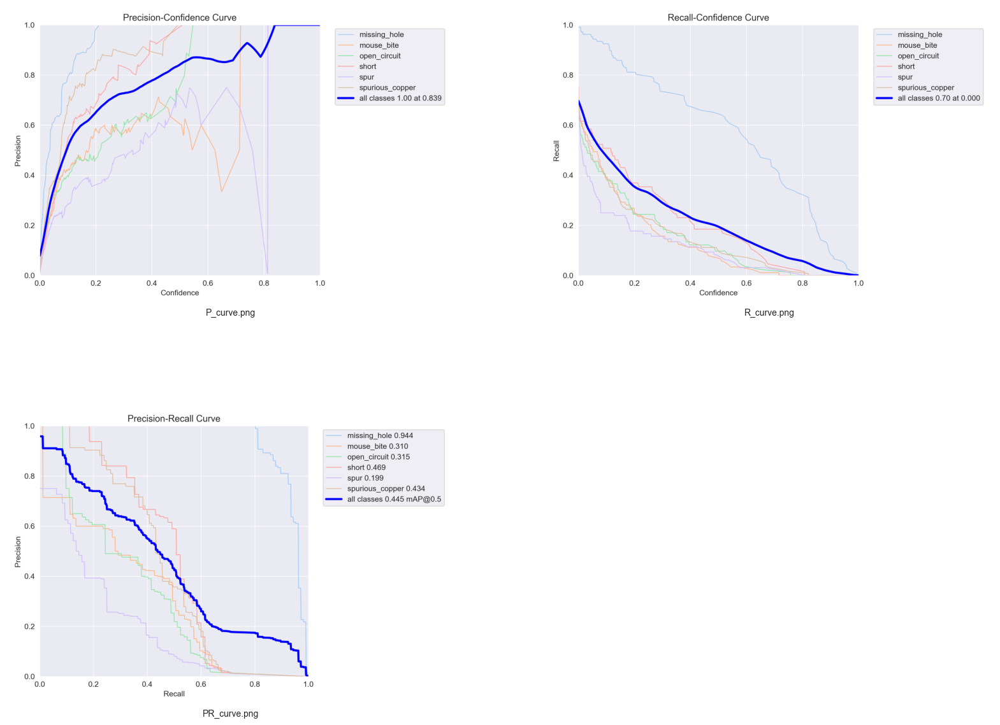

In [62]:
#Visualizing metrics
list_curve=['P_curve.png','R_curve.png','PR_curve.png']
visualize_result(result_dir,list_curve)

# Evaluating on val & Test Data

In [63]:
#Now let's load our best model to evaluate 
os.listdir(os.path.join(result_dir,'weights'))
best_model_path=os.path.join(result_dir,'weights','last.pt')
best_model=YOLO(best_model_path)

In [64]:
#Defing a function to view prediction against actual  along with bounding box

def draw_bounding_boxes_predict_actual(image_path,bounding_boxes_actual,bounding_boxes_predict,annotation_actual,annotation_predict):
    """
    Draws multiple bounding boxes on an image using Matplotlib.

    Args:
        image_path: The path to the image file.
        bounding_boxes: A list of bounding boxes, each represented as a tuple or list containing
                       (min_x, min_y, max_x, max_y).
    """
    
    # Load the image
    img = plt.imread(image_path)

    # Create a figure and axis
    fig, ax = plt.subplots(figsize=(10,10))

    # Display the image
    ax.imshow(img)

    # Draw each bounding box for actual
    for bbox in bounding_boxes_actual:
        min_x, min_y, max_x, max_y = bbox
        width = max_x - min_x
        height = max_y - min_y
        rect = patches.Rectangle((min_x, min_y), width, height, linewidth=1, edgecolor='red', facecolor='none')
        ax.add_patch(rect)
        
        # Calculate the centroid of the bounding box
        centroid_x = (min_x + max_x) / 2
        centroid_y = (min_y + max_y) / 2

        # Add the annotation to the centroid
        ax.annotate( annotation_actual,(centroid_x,centroid_y),(max_x+20,max_y+20),
            fontsize=10,color='white',
            horizontalalignment='right', verticalalignment='top')
        
     # Draw each bounding box for predicted
    for bbox in bounding_boxes_predict:
        min_x, min_y, max_x, max_y = bbox
        width = max_x - min_x
        height = max_y - min_y
        rect = patches.Rectangle((min_x, min_y), width, height, linewidth=1, edgecolor='yellow', facecolor='none')
        ax.add_patch(rect)
        
        # Calculate the centroid of the bounding box
        centroid_x = (min_x + max_x) / 2
        centroid_y = (min_y + max_y) / 2

        # Add the annotation to the centroid
        ax.annotate( annotation_predict,(centroid_x,centroid_y),(min_x-20,min_y-20),
            fontsize=10,color='white',
            horizontalalignment='right', verticalalignment='top')
        
    plt.grid(False)
    plt.xticks([])
    plt.yticks([])
    
    imagename=re.sub(r'.+/([\w_]+\.jpg)',r'\1',image_path)
    plt.xlabel(imagename)

    # Show the plot
plt.show()

In [65]:
def model_predict_compare(model, image_path, df_annot):
    result_test = model.predict(image_path)

    bounding_boxes_predict = []  # Ensure it's always initialized
    annotation_predict = ''

    for r in result_test:
        if r.boxes.xyxy.cpu().numpy().size != 0:
            bounding_boxes_predict = r.boxes.xyxy.cpu().numpy()  # Numpy array of bounding box
            class_dict = r.names  # Class dict
            pred_class = r.boxes.cls.cpu().numpy()[0].astype('int')  # Predicted classes
            annotation_predict = class_dict[pred_class]

    # Extract only the filename (without path) and normalize it
    filename = os.path.basename(image_path).strip().lower()
    df_annot['filename'] = df_annot['filename'].str.strip().str.lower()

    # Filter the annotation dataframe
    df_selected = df_annot[df_annot['filename'] == filename]

    if df_selected.empty:
        print(f"⚠️ Warning: No annotations found for {filename}, skipping...")
        return  # Skip processing this image

    xmin = df_selected['xmin'].values
    ymin = df_selected['ymin'].values
    xmax = df_selected['xmax'].values
    ymax = df_selected['ymax'].values

    annotation_actual = str(df_selected['class'].values[0])
    bounding_boxes_actual = zip(xmin, ymin, xmax, ymax)

    draw_bounding_boxes_predict_actual(
        image_path, bounding_boxes_actual, bounding_boxes_predict,
        'actual_' + annotation_actual, 'predicted_' + annotation_predict
    )



image 1/1 c:\Users\njhar\Downloads\dataset\images\val\01_missing_hole_01.jpg: 224x416 3 missing_holes, 77.7ms
Speed: 1.4ms preprocess, 77.7ms inference, 1.9ms postprocess per image at shape (1, 3, 224, 416)

image 1/1 c:\Users\njhar\Downloads\dataset\images\val\01_missing_hole_04.jpg: 224x416 2 missing_holes, 43.9ms
Speed: 1.7ms preprocess, 43.9ms inference, 2.3ms postprocess per image at shape (1, 3, 224, 416)

image 1/1 c:\Users\njhar\Downloads\dataset\images\val\01_missing_hole_12.jpg: 224x416 3 missing_holes, 44.0ms
Speed: 1.6ms preprocess, 44.0ms inference, 1.7ms postprocess per image at shape (1, 3, 224, 416)

image 1/1 c:\Users\njhar\Downloads\dataset\images\val\01_missing_hole_20.jpg: 224x416 1 missing_hole, 42.8ms
Speed: 1.4ms preprocess, 42.8ms inference, 4.7ms postprocess per image at shape (1, 3, 224, 416)

image 1/1 c:\Users\njhar\Downloads\dataset\images\val\01_mouse_bite_03.jpg: 224x416 (no detections), 44.1ms
Speed: 1.3ms preprocess, 44.1ms inference, 1.6ms postprocess

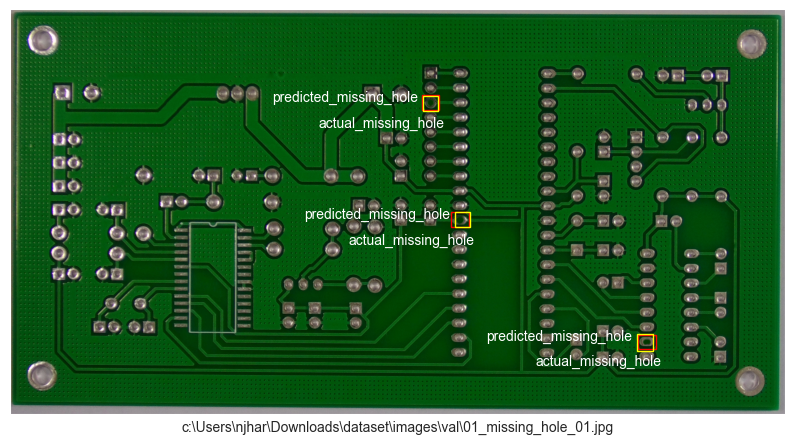

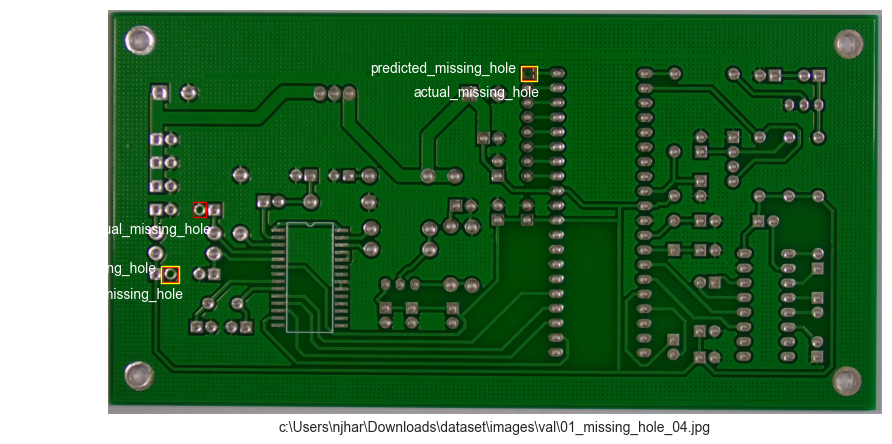

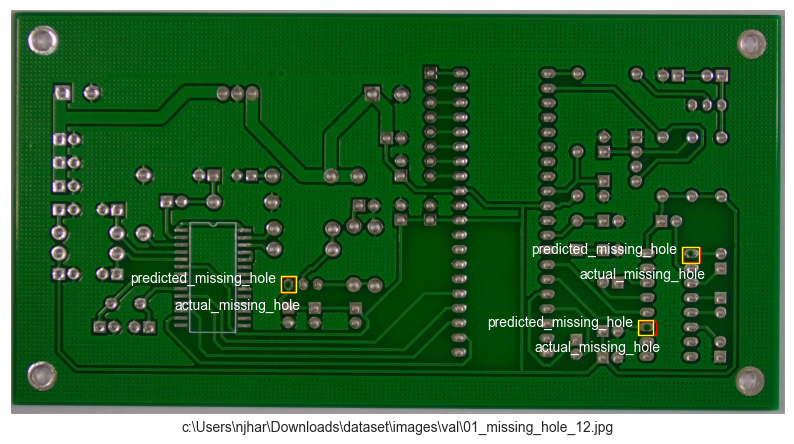

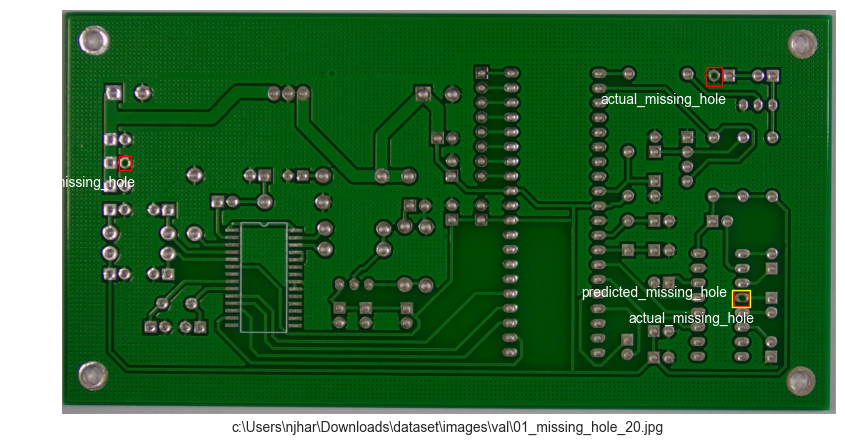

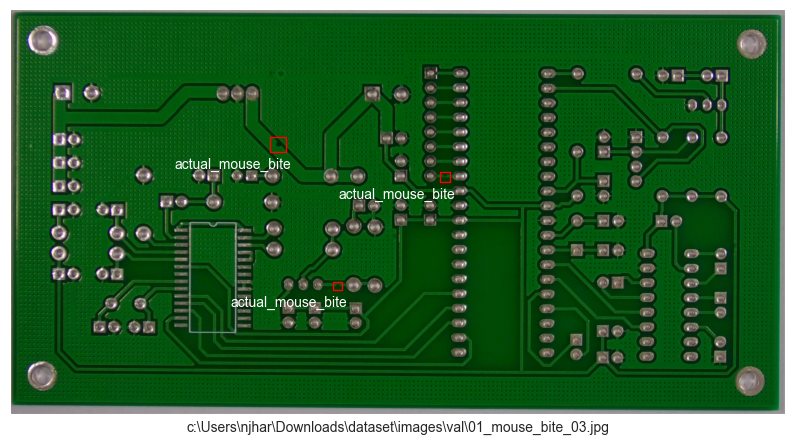

In [66]:
# Predicting on validation data for 5 images
val_image_dir = os.path.join(images_dir, 'val')
for i in os.listdir(val_image_dir)[:5]:
    model_predict_compare(best_model, os.path.join(val_image_dir, i), df_annot)


image 1/1 c:\Users\njhar\Downloads\dataset\images\test\01_missing_hole_07.jpg: 224x416 3 missing_holes, 45.0ms
Speed: 1.6ms preprocess, 45.0ms inference, 2.3ms postprocess per image at shape (1, 3, 224, 416)

image 1/1 c:\Users\njhar\Downloads\dataset\images\test\01_open_circuit_09.jpg: 224x416 (no detections), 40.1ms
Speed: 1.3ms preprocess, 40.1ms inference, 1.5ms postprocess per image at shape (1, 3, 224, 416)

image 1/1 c:\Users\njhar\Downloads\dataset\images\test\01_short_03.jpg: 224x416 (no detections), 48.1ms
Speed: 1.4ms preprocess, 48.1ms inference, 1.9ms postprocess per image at shape (1, 3, 224, 416)

image 1/1 c:\Users\njhar\Downloads\dataset\images\test\04_missing_hole_06.jpg: 352x416 2 missing_holes, 83.3ms
Speed: 2.1ms preprocess, 83.3ms inference, 1.9ms postprocess per image at shape (1, 3, 352, 416)

image 1/1 c:\Users\njhar\Downloads\dataset\images\test\04_missing_hole_08.jpg: 352x416 1 missing_hole, 72.1ms
Speed: 5.7ms preprocess, 72.1ms inference, 2.3ms postprocess

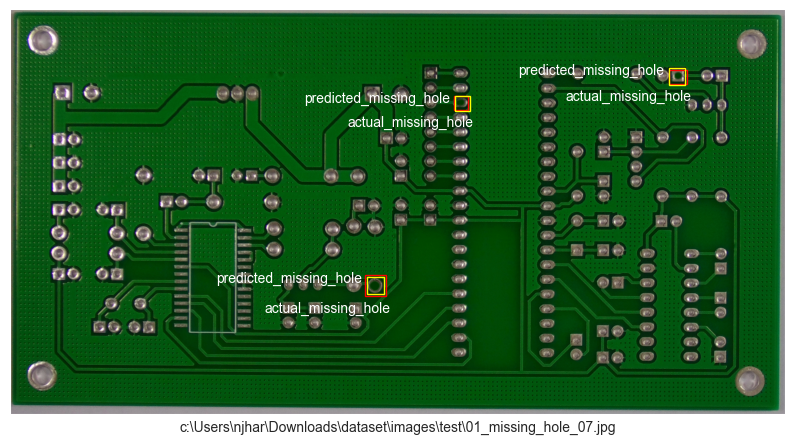

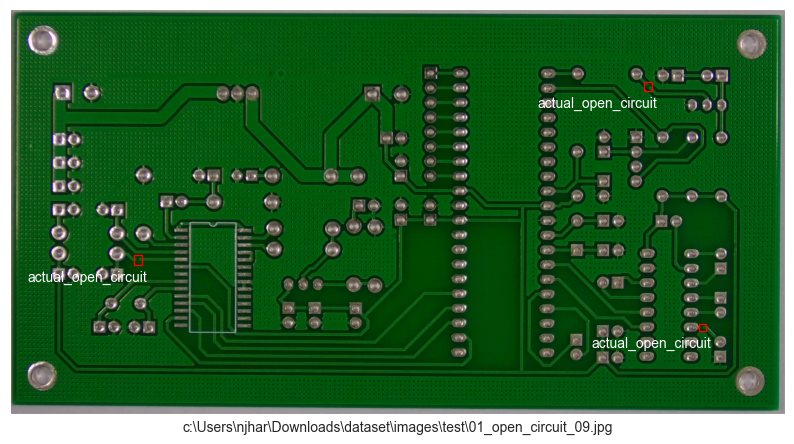

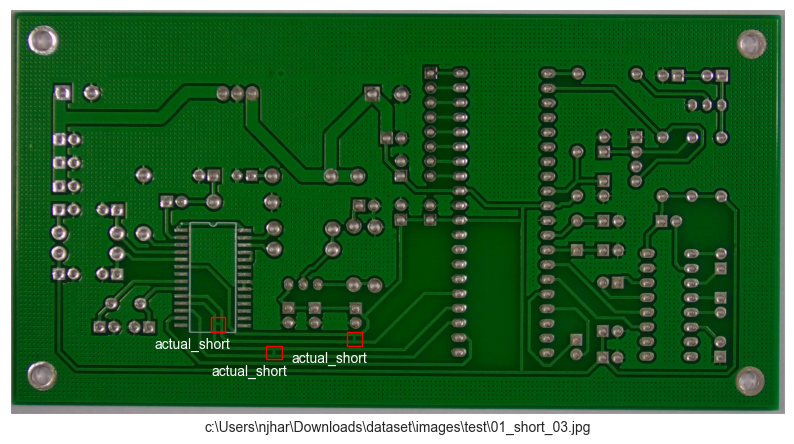

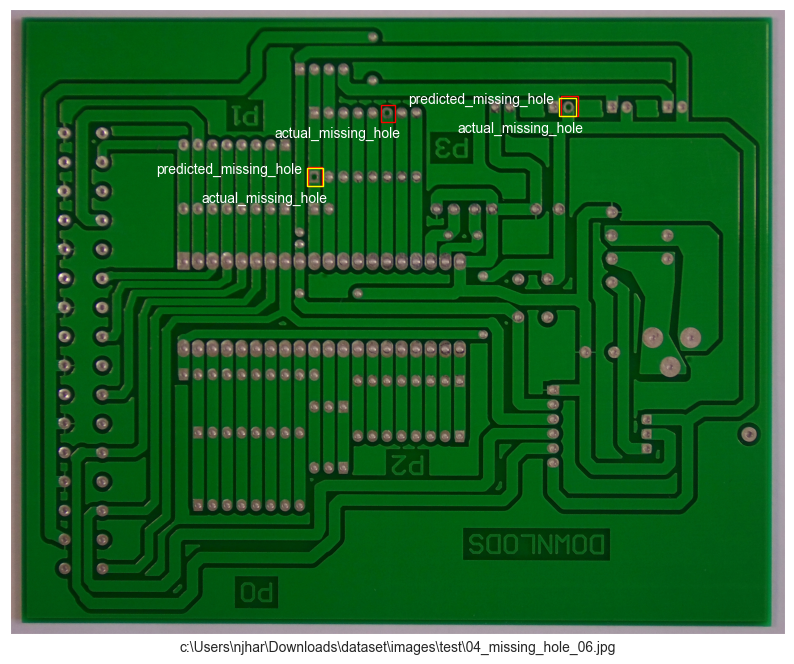

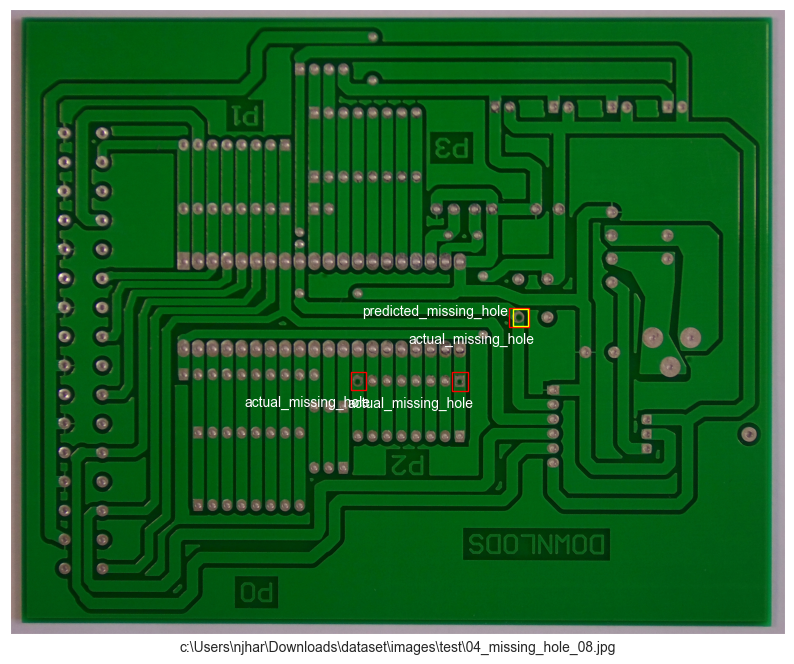

In [67]:
#Predicting on test data for 5 test images
test_image_dir=os.path.join(images_dir,'test')
for i in os.listdir(test_image_dir)[0:5]:
    model_predict_compare(best_model,os.path.join(test_image_dir,i),df_annot)

In [68]:
def move_to_dummy(original_dir,dummy_dir):
    if os.path.exists(dummy_dir):
        shutil.rmtree(dummy_dir) #Remove if exists
    os.makedirs(dummy_dir)
    
    images_dum_val_dir=os.path.join(dummy_dir,'images','val')
    labels_dum_val_dir=os.path.join(dummy_dir,'labels','val')
    images_dum_train_dir=os.path.join(dummy_dir,'images','train')
    labels_dum_train_dir=os.path.join(dummy_dir,'labels','train')
                  
    os.makedirs(images_dum_val_dir)
    os.makedirs(labels_dum_val_dir)
    os.makedirs(images_dum_train_dir)
    os.makedirs(labels_dum_train_dir)
    
    images_test_dir=os.path.join(original_dir,'images','test')
    labels_test_dir=os.path.join(original_dir,'labels','test')
    images_train_dir=os.path.join(original_dir,'images','train')
    labels_train_dir=os.path.join(original_dir,'labels','train')
    
    for i in os.listdir(images_test_dir):
        shutil.copy(os.path.join(images_test_dir,i),os.path.join(images_dum_val_dir,i))
    for i in os.listdir(labels_test_dir):
        shutil.copy(os.path.join(labels_test_dir,i),os.path.join(labels_dum_val_dir,i))
    for i in os.listdir(images_train_dir):
        shutil.copy(os.path.join(images_train_dir,i),os.path.join(images_dum_train_dir,i))
    for i in os.listdir(labels_train_dir):
        shutil.copy(os.path.join(labels_train_dir,i),os.path.join(labels_dum_train_dir,i))
original_dir=os.path.join(root_dir,'dataset')
dummy_dir=os.path.join(root_dir,'dummy_dataset')

move_to_dummy(original_dir,dummy_dir)

print(f"Length of image files:{len(os.listdir(os.path.join(dummy_dir,'images','val')))}")
print(f"Length of label files:{len(os.listdir(os.path.join(dummy_dir,'labels','val')))}")

Length of image files:35
Length of label files:35


In [69]:
#Creating YAML format
data_test_yaml={
    'path':str(os.path.join(root_dir,'dummy_dataset')),
    'train':'images/train',
    'val':'images/val',
    'nc': len(class_dict),
    'names': list(class_dict.values())
}
data_test_yaml

{'path': 'c:\\Users\\njhar\\Downloads\\dummy_dataset',
 'train': 'images/train',
 'val': 'images/val',
 'nc': 6,
 'names': ['missing_hole',
  'mouse_bite',
  'open_circuit',
  'short',
  'spur',
  'spurious_copper']}

In [70]:
#Creating yaml file
import yaml

#Writing to yaml file
with open('data_test.yaml', 'w') as f:
    yaml.dump(data_test_yaml, f, default_flow_style=False)

In [71]:
result_val=best_model.val(data=os.path.join(root_dir,'data_test.yaml'))

Ultralytics 8.3.96  Python-3.12.1 torch-2.6.0+cpu CPU (11th Gen Intel Core(TM) i5-1135G7 2.40GHz)


val: Scanning C:\Users\njhar\Downloads\dummy_dataset\labels\val... 35 images, 0 backgrounds, 0 corrupt: 100%|██████████| 35/35 [00:00<00:00, 243.24it/s]

val: New cache created: C:\Users\njhar\Downloads\dummy_dataset\labels\val.cache



                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:04<00:00,  1.42s/it]


                   all         35        152      0.587       0.45      0.485      0.205
          missing_hole          9         35      0.812      0.864      0.928      0.522
            mouse_bite          7         33      0.697      0.364       0.47      0.143
          open_circuit          4         16      0.303      0.312      0.204     0.0397
                 short          4         18      0.581        0.5      0.572       0.24
                  spur          3         15      0.553      0.467      0.454      0.181
       spurious_copper          8         35      0.576      0.195      0.285      0.104
Speed: 0.9ms preprocess, 45.3ms inference, 0.0ms loss, 1.0ms postprocess per image
Results saved to runs\detect\val


In [72]:
result_val_dir='runs/detect/val'

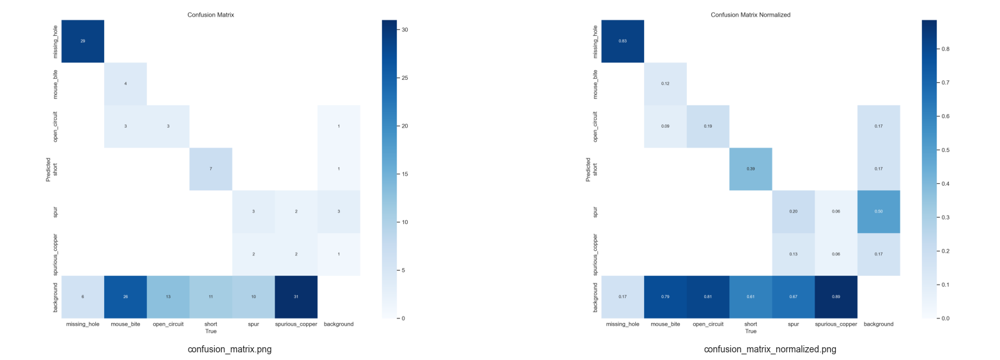

In [73]:
#Visualizing confusion matrix
list_confusion=['confusion_matrix.png','confusion_matrix_normalized.png']
visualize_result(result_val_dir,list_confusion)

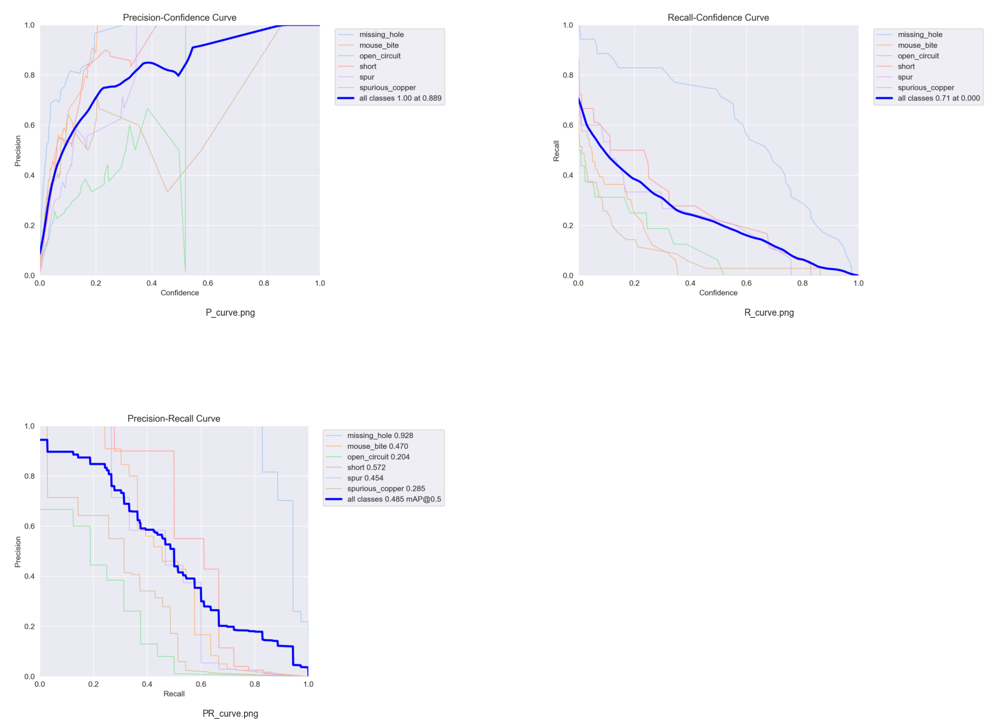

In [74]:
#Visualizing metrics
list_curve=['P_curve.png','R_curve.png','PR_curve.png']
visualize_result(result_val_dir,list_curve)


# Creating a function to predict & return annoted image

In [76]:
#Defing a function to view image along with bounding box

def draw_bounding_boxes_image(image_path, bounding_boxes,annotation):
    """
    Draws multiple bounding boxes on an image using Matplotlib.

    Args:
        image_path: The path to the image file.
        bounding_boxes: A list of bounding boxes, each represented as a tuple or list containing
                       (min_x, min_y, max_x, max_y).
    """
    
    # Load the image
    img = plt.imread(image_path)

    # Create a figure and axis
    fig, ax = plt.subplots(figsize=(10,10))

    # Display the image
    ax.imshow(img)

    # Draw each bounding box for actual
    if len(bounding_boxes)==0:
        plt.text(0.5, 0.5, 'No defects detected',        
                 horizontalalignment='center',verticalalignment='center',color='white',fontsize=16)
        
    else:   
        for bbox in bounding_boxes:
            min_x, min_y, max_x, max_y = bbox
            width = max_x - min_x
            height = max_y - min_y
            rect = patches.Rectangle((min_x, min_y), width, height, linewidth=1, edgecolor='red', facecolor='none')
            ax.add_patch(rect)

            # Calculate the centroid of the bounding box
            centroid_x = (min_x + max_x) / 2
            centroid_y = (min_y + max_y) / 2

            # Add the annotation to the centroid
            ax.annotate( annotation,(centroid_x,centroid_y),(max_x+20,max_y+20),
                fontsize=10,color='white',
                horizontalalignment='right', verticalalignment='top')

        
    plt.grid(False)
    plt.xticks([])
    plt.yticks([])
    
    imagename=re.sub(r'.+/([\w_]+\.jpg)',r'\1',image_path)
    plt.xlabel(imagename)

    # Show the plot
    plt.show()
#Defining the function to predict and return annoted image
def model_predict(model,image_path):

    result_test=model.predict(image_path)
    for r in result_test:
        if r.boxes.xyxy.cpu().numpy().size!=0:
            bounding_boxes=r.boxes.xyxy.cpu().numpy()  #Numpy array of bounding box
            class_dict=r.names                         #Class dict
            pred_class=r.boxes.cls.cpu().numpy()[0].astype('int') #Predicted classes
            annotation=class_dict[pred_class]
        else:
            bounding_boxes=[]
            annotation=''
        
    
    
    draw_bounding_boxes_image(image_path, bounding_boxes,annotation)



image 1/1 c:\Users\njhar\Downloads\dummy_dataset\images\val\01_missing_hole_07.jpg: 224x416 3 missing_holes, 43.5ms
Speed: 1.5ms preprocess, 43.5ms inference, 2.9ms postprocess per image at shape (1, 3, 224, 416)


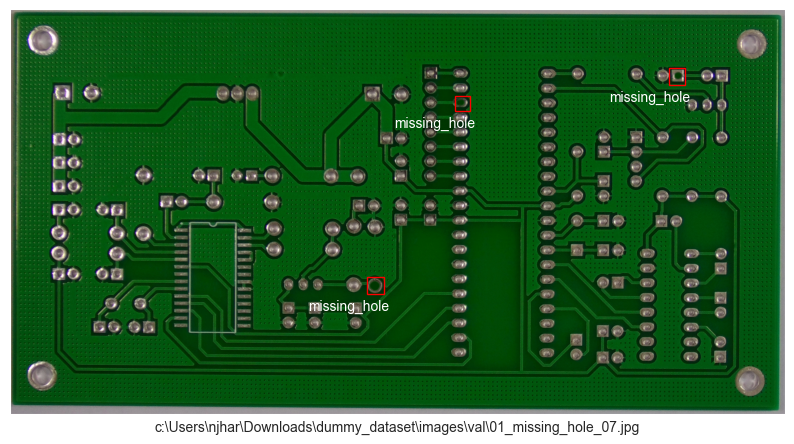


image 1/1 c:\Users\njhar\Downloads\dummy_dataset\images\val\01_short_03.jpg: 224x416 (no detections), 59.0ms
Speed: 1.8ms preprocess, 59.0ms inference, 1.7ms postprocess per image at shape (1, 3, 224, 416)


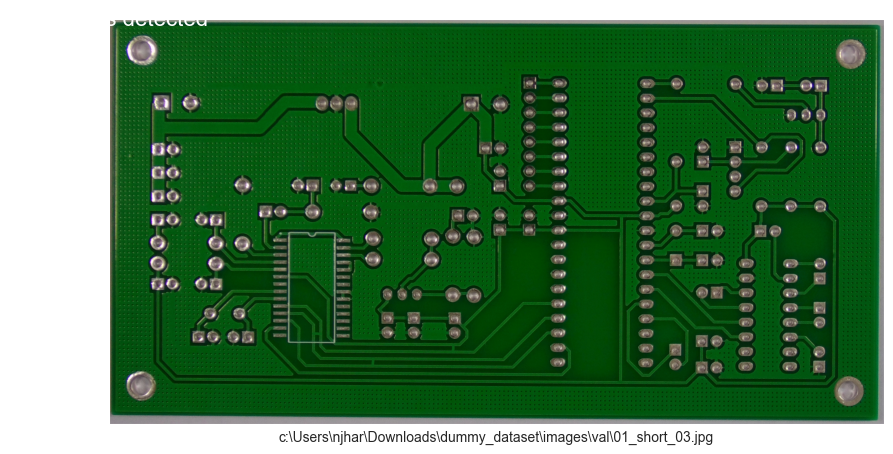


image 1/1 c:\Users\njhar\Downloads\dummy_dataset\images\val\04_missing_hole_08.jpg: 352x416 1 missing_hole, 71.8ms
Speed: 3.1ms preprocess, 71.8ms inference, 2.7ms postprocess per image at shape (1, 3, 352, 416)


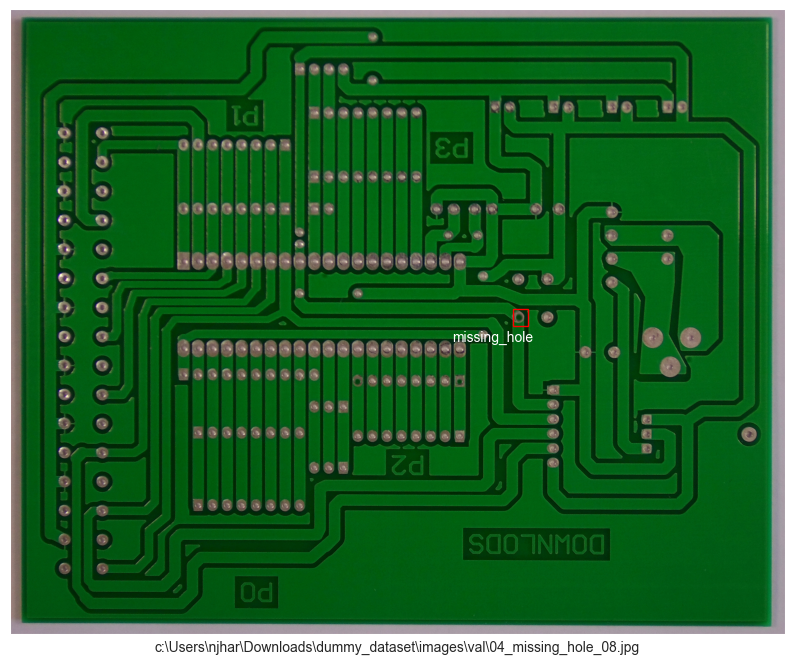


image 1/1 c:\Users\njhar\Downloads\dummy_dataset\images\val\04_missing_hole_13.jpg: 352x416 3 missing_holes, 126.2ms
Speed: 4.6ms preprocess, 126.2ms inference, 7.1ms postprocess per image at shape (1, 3, 352, 416)


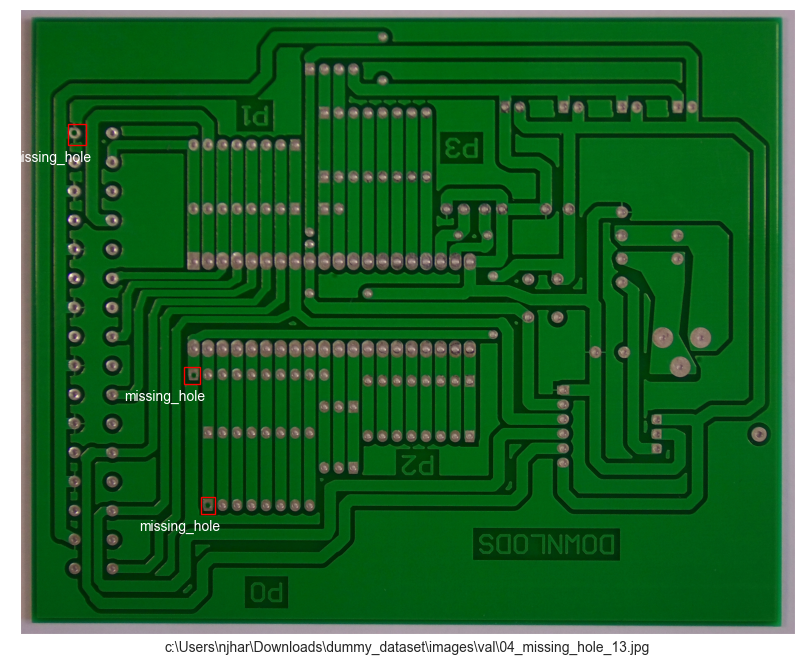


image 1/1 c:\Users\njhar\Downloads\dummy_dataset\images\val\04_open_circuit_01.jpg: 352x416 1 open_circuit, 79.7ms
Speed: 2.7ms preprocess, 79.7ms inference, 5.0ms postprocess per image at shape (1, 3, 352, 416)


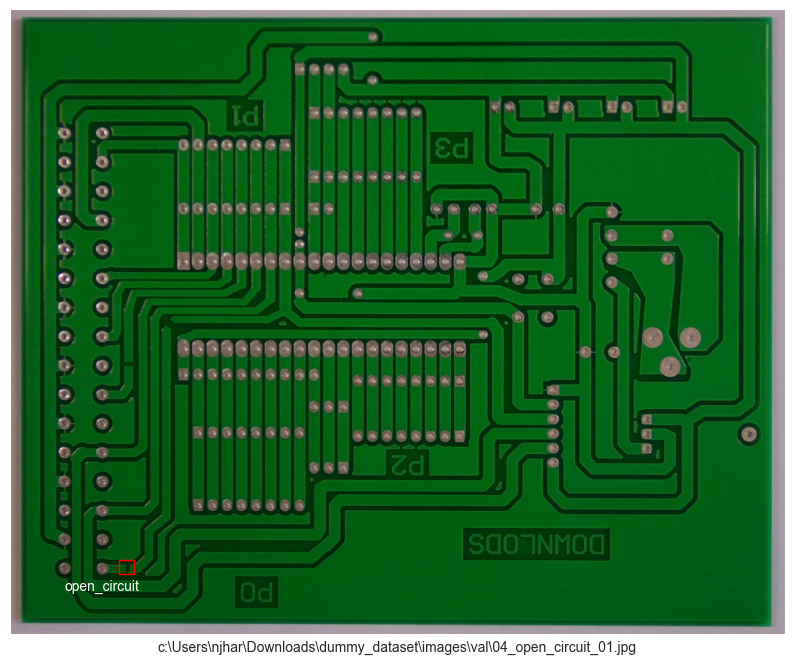

In [77]:
#Testing on sample data
for i in os.listdir(os.path.join(dummy_dir,'images','val'))[0:10:2]:
    image_path=os.path.join(dummy_dir,'images','val',i)
    model_predict(model=best_model,image_path=image_path)

# model saving

In [1]:
from ultralytics import YOLO

# Load the trained model
model = YOLO("runs/detect/train/weights/best.pt")

# ✅ Correct way to save a YOLO model
model.export(format="torch")  # Saves the model correctly

print("✅ Model saved successfully as 'best.torchscript.pt'!")


WARNING  Invalid export format='torch', updating to format='torchscript'
Ultralytics 8.3.96  Python-3.12.1 torch-2.6.0+cpu CPU (11th Gen Intel Core(TM) i5-1135G7 2.40GHz)
Model summary (fused): 72 layers, 3,006,818 parameters, 0 gradients, 8.1 GFLOPs

PyTorch: starting from 'runs\detect\train\weights\best.pt' with input shape (1, 3, 416, 416) BCHW and output shape(s) (1, 10, 3549) (5.9 MB)

TorchScript: starting export with torch 2.6.0+cpu...
TorchScript: export success  2.1s, saved as 'runs\detect\train\weights\best.torchscript' (11.8 MB)

Export complete (2.5s)
Results saved to C:\Users\njhar\Downloads\runs\detect\train\weights
Predict:         yolo predict task=detect model=runs\detect\train\weights\best.torchscript imgsz=416  
Validate:        yolo val task=detect model=runs\detect\train\weights\best.torchscript imgsz=416 data=c:\Users\njhar\Downloads\data.yaml  
Visualize:       https://netron.app
✅ Model saved successfully as 'best.torchscript.pt'!
